# How much is this car worth?

**Goal**: Providing guideline for determining the starting negotiation price of used cars when posting and search in Craigslist

In [1]:
import pandas as pd
import numpy as np
import cufflinks as cf
import matplotlib.pyplot as plt
import seaborn as sns
import plotly_express as px

cf.set_config_file(offline=True)
pd.set_option('display.max_columns', 800)
#pd.set_option('display.expand_frame_repr', False)
#pd.set_option('max_colwidth', -1)

# Data acquisition

Data is obtained from the web scrapping of California craigslist site from June 21, 2019 to June 27, 2019 (7 Days).

In [2]:
data_acc=pd.read_csv('data/data_acc.csv')

In [3]:
data_acc.head()

,city,day_1,day_2,day_3,day_4,day_5,day_6,final
0,SF bay area,2895,5138,6676,9165,11582,13818,15937
1,bakersfield,2976,3180,3337,3464,3569,3704,3848
2,chico,2116,2203,2273,2350,2434,2538,2614
3,fresno / madera,2984,3380,3610,3822,4150,4475,4733
4,gold country,1046,1081,1105,1141,1179,1242,1279


In [4]:
data_acc.iplot(x='city', kind='bar', colorscale='paired')

In [5]:
raw_df=pd.read_csv('data/train.csv')

In [6]:
raw_df.head()

,url,city,city_url,price,year,manufacturer,make,condition,cylinders,fuel,odometer,title_status,transmission,VIN,drive,size,type,paint_color,image_url,desc,lat,long
0,https://sfbay.craigslist.org/pen/cto/d/burling...,SF bay area,https://sfbay.craigslist.org,8300,2002.0,subaru,wrx,excellent,6 cylinders,gas,136000.0,clean,manual,JF1GD29612G530659,fwd,mid-size,sedan,silver,https://images.craigslist.org/00w0w_1oU3Pjw6Wp...,SMOG & TITLE IN HAND\n\nSelling my 2002 Subaru...,37.593335,-122.371382
1,https://sfbay.craigslist.org/eby/cto/d/newark-...,SF bay area,https://sfbay.craigslist.org,6900,2008.0,bmw,x5 3.0si,NaN,NaN,gas,170226.0,clean,automatic,NaN,NaN,NaN,NaN,NaN,https://images.craigslist.org/00D0D_dr9095I0qa...,"Very well maintained, clean title, passed smog...",37.536800,-122.032000
2,https://sfbay.craigslist.org/nby/cto/d/bodega-...,SF bay area,https://sfbay.craigslist.org,6000,1984.0,mercedes-benz,benz 300d turbo,excellent,5 cylinders,diesel,231460.0,clean,automatic,WDBAB33A3EA098073,rwd,NaN,sedan,NaN,https://images.craigslist.org/00E0E_5bJKkBMkWO...,Excellent Condition. Runs very well. Low miles...,38.351400,-122.974100
3,https://sfbay.craigslist.org/eby/ctd/d/sacrame...,SF bay area,https://sfbay.craigslist.org,11994,2012.0,bmw,x3,NaN,NaN,gas,112181.0,clean,automatic,5UXWX5C59CL726287,NaN,NaN,SUV,NaN,https://images.craigslist.org/00o0o_jGwC18qak2...,2012 BMW X3\n\n\n\n\nOffered by: CAR EXPO AUTO...,38.605580,-121.402110
4,https://sfbay.craigslist.org/sfc/ctd/d/salinas...,SF bay area,https://sfbay.craigslist.org,4999,2003.0,mercedes-benz,s 430,NaN,NaN,gas,149372.0,clean,automatic,WDBNG70J13A378716,rwd,NaN,sedan,silver,https://images.craigslist.org/00n0n_cjrWXI2Vge...,2003 Mercedes-Benz S 430 4 Door Sedan Sedan20...,36.759421,-121.666000


In [7]:
raw_df.columns

Index(['url', 'city', 'city_url', 'price', 'year', 'manufacturer', 'make',
       'condition', 'cylinders', 'fuel', 'odometer', 'title_status',
       'transmission', 'VIN', 'drive', 'size', 'type', 'paint_color',
       'image_url', 'desc', 'lat', 'long'],
      dtype='object')

In [8]:
df=raw_df[['city','price', 'year', 'manufacturer', 'make',
       'condition', 'cylinders', 'fuel', 'odometer', 'title_status',
       'transmission','drive', 'size', 'type', 'paint_color','lat', 'long']]

In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 82028 entries, 0 to 82027
Data columns (total 17 columns):
city            82028 non-null object
price           82028 non-null int64
year            81912 non-null float64
manufacturer    77063 non-null object
make            79728 non-null object
condition       44219 non-null object
cylinders       47570 non-null object
fuel            81805 non-null object
odometer        65855 non-null float64
title_status    81645 non-null object
transmission    81276 non-null object
drive           57470 non-null object
size            26499 non-null object
type            60654 non-null object
paint_color     55660 non-null object
lat             81706 non-null float64
long            81706 non-null float64
dtypes: float64(4), int64(1), object(12)
memory usage: 10.6+ MB


In [10]:
df.head()

,city,price,year,manufacturer,make,condition,cylinders,fuel,odometer,title_status,transmission,drive,size,type,paint_color,lat,long
0,SF bay area,8300,2002.0,subaru,wrx,excellent,6 cylinders,gas,136000.0,clean,manual,fwd,mid-size,sedan,silver,37.593335,-122.371382
1,SF bay area,6900,2008.0,bmw,x5 3.0si,NaN,NaN,gas,170226.0,clean,automatic,NaN,NaN,NaN,NaN,37.536800,-122.032000
2,SF bay area,6000,1984.0,mercedes-benz,benz 300d turbo,excellent,5 cylinders,diesel,231460.0,clean,automatic,rwd,NaN,sedan,NaN,38.351400,-122.974100
3,SF bay area,11994,2012.0,bmw,x3,NaN,NaN,gas,112181.0,clean,automatic,NaN,NaN,SUV,NaN,38.605580,-121.402110
4,SF bay area,4999,2003.0,mercedes-benz,s 430,NaN,NaN,gas,149372.0,clean,automatic,rwd,NaN,sedan,silver,36.759421,-121.666000


In [11]:
df.drop(df.loc[(df.price>9**5)|(df.price<50)].index, inplace=True)
df.drop(df.loc[(df.year>2019)&(df.price<15000)].index, inplace=True)

In [12]:
df.corr().columns

Index(['price', 'year', 'odometer', 'lat', 'long'], dtype='object')

In [13]:
px.scatter_matrix(df, dimensions=['price', 'year', 'odometer', 'lat', 'long'], color='city')

In [14]:
# fig=plt.subplots(1, figsize=(13,10))
# sns.heatmap(df.corr(), annot=True, linewidth=1);

In [15]:
#pd.plotting.scatter_matrix(df[['price', 'year', 'odometer', 'lat', 'long']], figsize=(13,10));

In [16]:
#df.plot(kind='scatter',x='year', y='price', figsize=(20,12), fontsize=20);

In [17]:
px.scatter(df, x='year', y='price', color='city')

In [18]:
px.box(df, x='city', y='price', notched=True)

In [19]:
px.histogram(df, x='manufacturer')

In [20]:
#ax=df.boxplot(column='price', by='city', figsize=(15,10), fontsize=20, rot=90)

## To do
- px plot is working good. Converting to px plot
- location plot, time dependent posting per location if possible

# Data Cleaning - Car model part

In [21]:
cat_col=df.select_dtypes('object').columns
print(cat_col)

Index(['city', 'manufacturer', 'make', 'condition', 'cylinders', 'fuel',
       'title_status', 'transmission', 'drive', 'size', 'type', 'paint_color'],
      dtype='object')


In [22]:
unique_val=[df[i].value_counts(dropna=False) for i in cat_col]

In [23]:
[(i.count()) for i in unique_val]

[29, 41, 11530, 7, 9, 6, 7, 4, 4, 5, 14, 13]

In [24]:
#from sklearn.feature_extraction.text import TfidfVectorizer

In [25]:
distinc=20

In [26]:
car_kinds=[]
for i in list(df.make.value_counts()[df.make.value_counts()>distinc].index):
    for j in i.split():
        car_kinds.append(j.lower())
car_kinds=list(set(car_kinds))

In [27]:
year_str=[str(i) for i in list(range(1915, 2020))]
company_str=[i.lower() for i in df.manufacturer.value_counts().index]

In [28]:
make_list=[str(i).lower()
           .replace('-','').replace('&','').replace('&','').replace('+','')
           for i in df.make]
for k,i in enumerate(make_list):
    for j in year_str:
        make_list[k]=i.replace(j,'')
    for l in company_str:
        make_list[k]=i.replace(l,'')
make_list=[i.split() if len(i)>2 else i for i in make_list]

In [29]:
model_lst=[]
for i in make_list:
    model=[]
    for j in i:
        if j in car_kinds:
            model.append(j)
    if len(model)==0:
        #print(j)    'nan' passing for null values
        model_lst.append(j)
    else:
         model_lst.append(model)  
model_lst=[list(set(i)) if type(i)==list else i for i in model_lst]

In [30]:
car_model_list=[' '.join(sorted(i, reverse=True)) if type(i)==list else i for i in model_lst]

In [31]:
df['make_new']=car_model_list

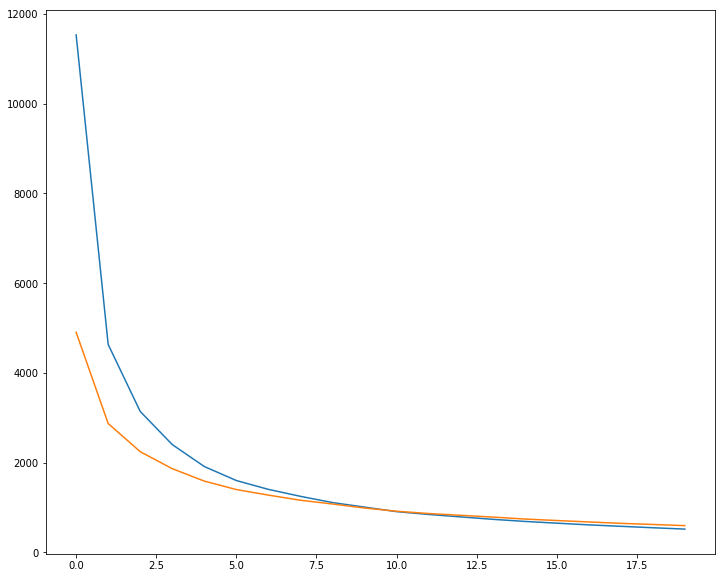

In [32]:
fig, ax =plt.subplots(1, figsize=(12,10))
x=list(range(20))
y=[df.make.value_counts()[df.make.value_counts()>i].count() for i in x]
y_new=[df['make_new'].value_counts()[df['make_new'].value_counts()>i].count() for i in x]

plt.plot(x,y)
plt.plot(x,y_new)

In [33]:
df.make_new.value_counts()

nan                             2045
f150                            1179
accord                          1080
civic                           1073
camry                            889
tacoma                           850
prius                            727
silverado                        698
corolla                          679
silverado 1500                   678
mustang                          673
f250                             640
altima                           603
2500                             589
wrangler                         570
1500                             544
tundra                           502
focus                            493
tahoe                            473
3                                451
5                                428
crv                              423
camaro                           394
grand cherokee                   382
jetta                            378
sentra                           371
explorer                         366
f